In [1]:
import copy
import random

import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
import numpy
import scipy
import scipy.sparse
import sklearn
from sklearn.decomposition import PCA
import statistics

import scanpy as sc
import squidpy as sq

C:\Users\Workstation\magistrale\algo_ai\Lib\site-packages\dask\dataframe\__init__.py:31: FutureWarning: The legacy Dask DataFrame implementation is deprecated and will be removed in a future version. Set the configuration option `dataframe.query-planning` to `True` or None to enable the new Dask Dataframe implementation and silence this warning.
  warnings.warn(
C:\Users\Workstation\magistrale\algo_ai\Lib\site-packages\numba\core\decorators.py:246: RuntimeWarning: nopython is set for njit and is ignored
  warnings.warn('nopython is set for njit and is ignored', RuntimeWarning)
C:\Users\Workstation\magistrale\algo_ai\Lib\site-packages\anndata\utils.py:429: FutureWarning: Importing read_text from `anndata` is deprecated. Import anndata.io.read_text instead.
  warnings.warn(msg, FutureWarning)


C:\Users\Workstation\magistrale\algo_ai\Lib\site-packages\anndata\_core\anndata.py:1758: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
C:\Users\Workstation\magistrale\algo_ai\Lib\site-packages\anndata\_core\anndata.py:1758: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


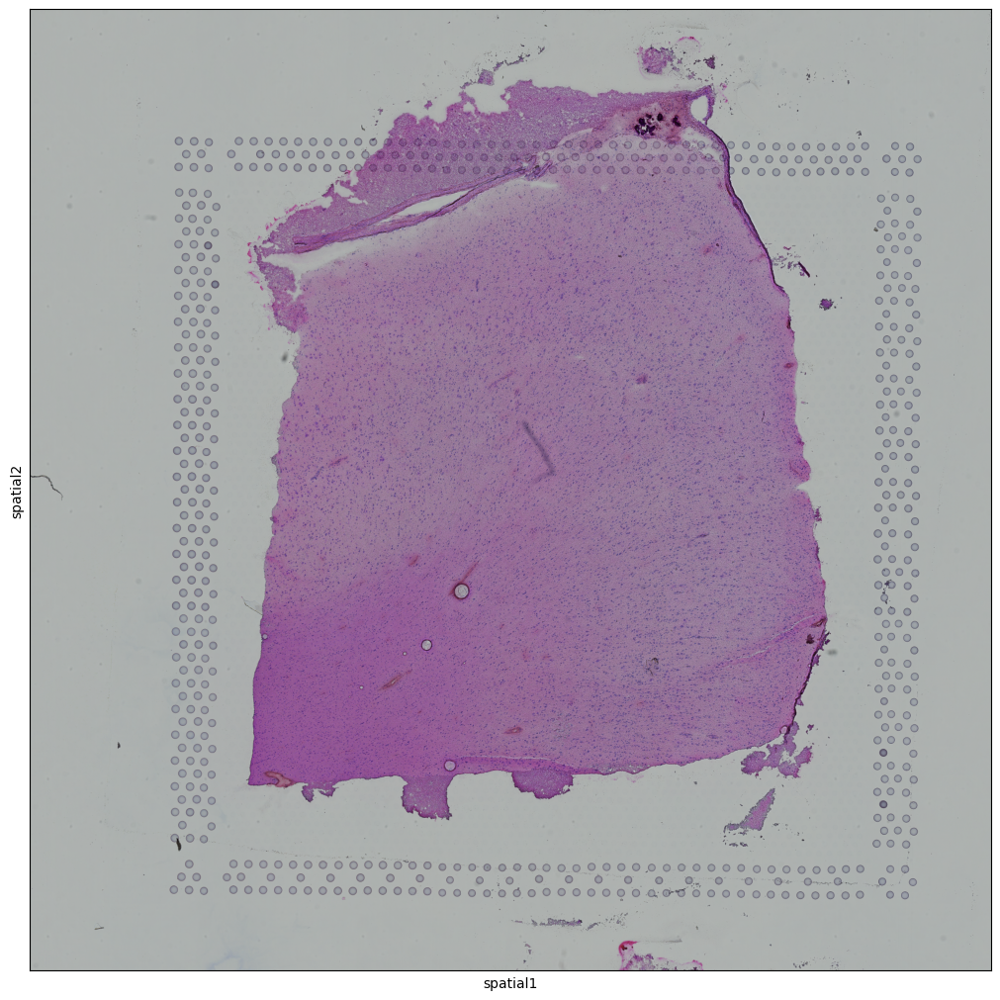

In [2]:
h5ad_file =       '1.DLPFC/151673/scRNA.h5ad'
expression_file = '1.DLPFC/151673/filtered_feature_bc_matrix.h5'
oprefix =         'DLPFC-151673'

adata_gene_expression = sc.read_visium('1.DLPFC/151673', count_file='filtered_feature_bc_matrix.h5', load_images=True)
adata_gene_expression.var_names_make_unique()

scdata = adata_gene_expression
sq.pl.spatial_scatter(scdata, figsize=(10,10), save=oprefix+'/background.png')

In [3]:
def get_sp_neighs(scdata):
    
    inverse_coords = dict()
    for ind in scdata.obs.index:
        inverse_coords[( scdata.obs['array_row'][ind], scdata.obs['array_col'][ind])] = ind
    
    sp_neighs = dict()
    for ind in scdata.obs.index:
        sp_neighs[ind] = set()
        ind_col = scdata.obs['array_col'][ind]
        ind_row = scdata.obs['array_row'][ind]

        if (ind_row, ind_col-2) in inverse_coords:
            sp_neighs[ind].add( inverse_coords[ (ind_row, ind_col-2) ]  )
        if (ind_row, ind_col+2) in inverse_coords:
            sp_neighs[ind].add( inverse_coords[ (ind_row, ind_col+2) ]  )

        if (ind_row-1, ind_col-1) in inverse_coords:
            sp_neighs[ind].add( inverse_coords[ (ind_row-1, ind_col-1) ]  )
        if (ind_row-1, ind_col+1) in inverse_coords:
            sp_neighs[ind].add( inverse_coords[ (ind_row-1, ind_col+1) ]  )

        if (ind_row+1, ind_col-1) in inverse_coords:
            sp_neighs[ind].add( inverse_coords[ (ind_row+1, ind_col-1) ]  )
        if (ind_row+1, ind_col+1) in inverse_coords:
            sp_neighs[ind].add( inverse_coords[ (ind_row+1, ind_col+1) ]  )   
            
    return sp_neighs

In [177]:
sp_neighs = get_sp_neighs(scdata)
print('nof spots', len(sp_neighs),  '; distinct nof neighbors', set([ len(v) for v in sp_neighs.values()  ]) )

nof spots 3639 ; distinct nof neighbors {0, 1, 2, 3, 4, 5, 6}


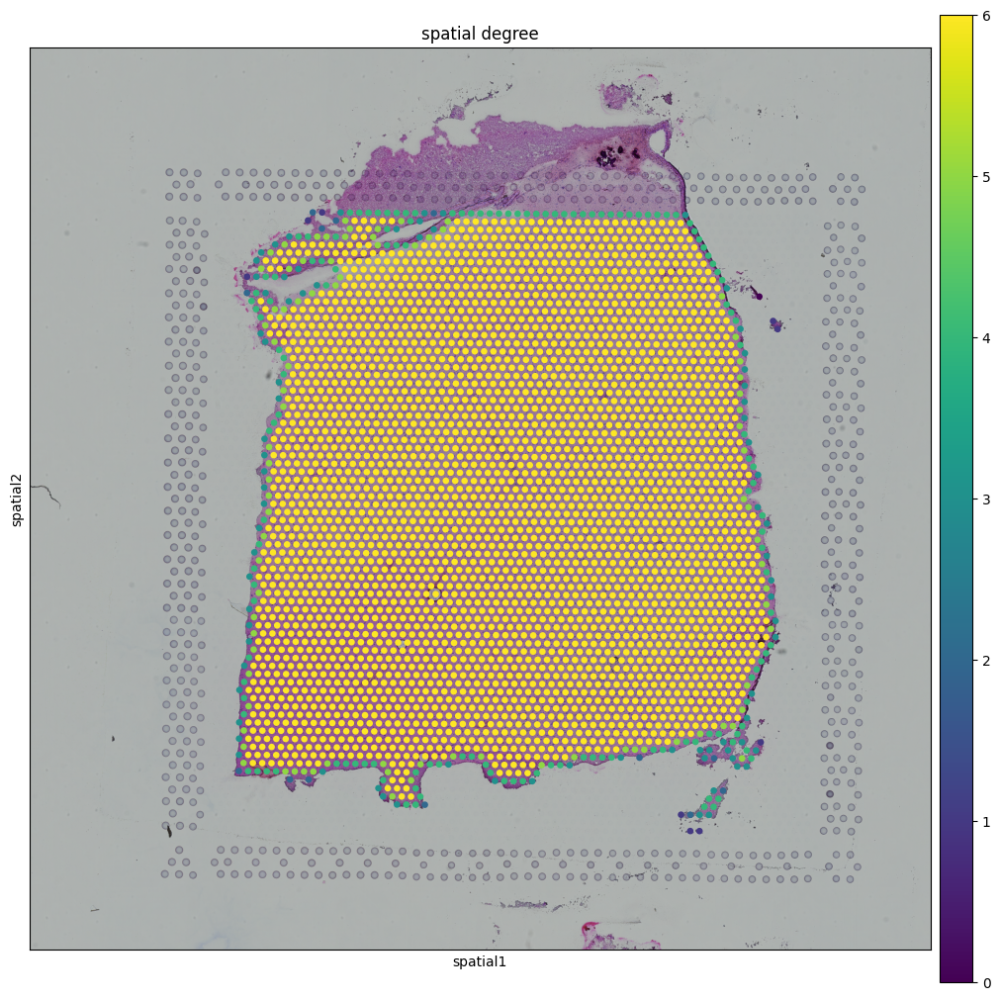

In [179]:
degreee_colors = list()
for ind in scdata.obs.index:
    degreee_colors.append(len(sp_neighs[ind]))
    
scdata.obs["cluster"] = degreee_colors
sq.pl.spatial_scatter(scdata, color="cluster", figsize=(10,10), title='spatial degree')

In [180]:
gene_names = adata_gene_expression.var_names
cell_names = adata_gene_expression.obs_names

data_gene_exp = pd.DataFrame(scdata.X.transpose().toarray())
data_gene_exp.columns = list(cell_names)
display(data_gene_exp)

,AAACAAGTATCTCCCA-1,AAACAATCTACTAGCA-1,AAACACCAATAACTGC-1,AAACAGAGCGACTCCT-1,AAACAGCTTTCAGAAG-1,AAACAGGGTCTATATT-1,AAACAGTGTTCCTGGG-1,AAACATTTCCCGGATT-1,AAACCCGAACGAAATC-1,AAACCGGGTAGGTACC-1,...,TTGTGTATGCCACCAA-1,TTGTGTTTCCCGAAAG-1,TTGTTAGCAAATTCGA-1,TTGTTCAGTGTGCTAC-1,TTGTTGTGTGTCAAGA-1,TTGTTTCACATCCAGG-1,TTGTTTCATTAGTCTA-1,TTGTTTCCATACAACT-1,TTGTTTGTATTACACG-1,TTGTTTGTGTAAATTC-1
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
33533,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
33534,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
33535,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
33536,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [181]:
gene_exp_count = data_gene_exp.sum(axis=1)

print(gene_exp_count.max())
print(gene_exp_count.min())
print(gene_exp_count.mean())
print(gene_exp_count.std())

491877.0
0.0
497.98035
5527.439


In [182]:
data_gene_exp

,AAACAAGTATCTCCCA-1,AAACAATCTACTAGCA-1,AAACACCAATAACTGC-1,AAACAGAGCGACTCCT-1,AAACAGCTTTCAGAAG-1,AAACAGGGTCTATATT-1,AAACAGTGTTCCTGGG-1,AAACATTTCCCGGATT-1,AAACCCGAACGAAATC-1,AAACCGGGTAGGTACC-1,...,TTGTGTATGCCACCAA-1,TTGTGTTTCCCGAAAG-1,TTGTTAGCAAATTCGA-1,TTGTTCAGTGTGCTAC-1,TTGTTGTGTGTCAAGA-1,TTGTTTCACATCCAGG-1,TTGTTTCATTAGTCTA-1,TTGTTTCCATACAACT-1,TTGTTTGTATTACACG-1,TTGTTTGTGTAAATTC-1
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
33533,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
33534,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
33535,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
33536,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [183]:
scdata.X.toarray().shape

(3639, 33538)

In [184]:
scdata.obs

,in_tissue,array_row,array_col,cluster
AAACAAGTATCTCCCA-1,1,50,102,6
AAACAATCTACTAGCA-1,1,3,43,3
AAACACCAATAACTGC-1,1,59,19,6
AAACAGAGCGACTCCT-1,1,14,94,6
AAACAGCTTTCAGAAG-1,1,43,9,5
...,...,...,...,...
TTGTTTCACATCCAGG-1,1,58,42,6
TTGTTTCATTAGTCTA-1,1,60,30,6
TTGTTTCCATACAACT-1,1,45,27,6
TTGTTTGTATTACACG-1,1,73,41,4


In [185]:
scdata.var

,gene_ids,feature_types,genome
MIR1302-2HG,ENSG00000243485,Gene Expression,GRCh38
FAM138A,ENSG00000237613,Gene Expression,GRCh38
OR4F5,ENSG00000186092,Gene Expression,GRCh38
AL627309.1,ENSG00000238009,Gene Expression,GRCh38
AL627309.3,ENSG00000239945,Gene Expression,GRCh38
...,...,...,...
AC233755.2,ENSG00000277856,Gene Expression,GRCh38
AC233755.1,ENSG00000275063,Gene Expression,GRCh38
AC240274.1,ENSG00000271254,Gene Expression,GRCh38
AC213203.1,ENSG00000277475,Gene Expression,GRCh38


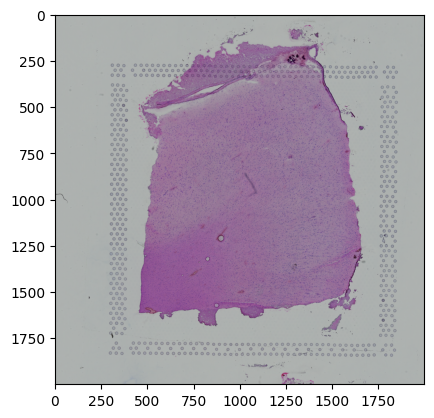

In [186]:
plt.imshow(scdata.uns["spatial"]["151673"]["images"]["hires"]) # lowres
plt.show()

In [187]:
import numpy as np
from random import choice

def plot_gene_expression(scdata, gene_id, path=None):
    gene_data = scdata.X.toarray().T[gene_id]
    scdata.obs["show_gene"] = list(gene_data)
    sq.pl.spatial_scatter(scdata, color="show_gene", figsize=(10,10), title=f'gene n_{gene_id}', img_alpha=0.5, save=path)

def plot_one_in_range(scdata, min_expr, max_expr):
    tot_gen_expression = scdata.X.toarray().sum(axis=0)
    in_range_gene_ids  = np.where(np.logical_and(tot_gen_expression>=min_expr, tot_gen_expression<=max_expr))
    plot_gene_expression(scdata, choice(list(in_range_gene_ids[0])))

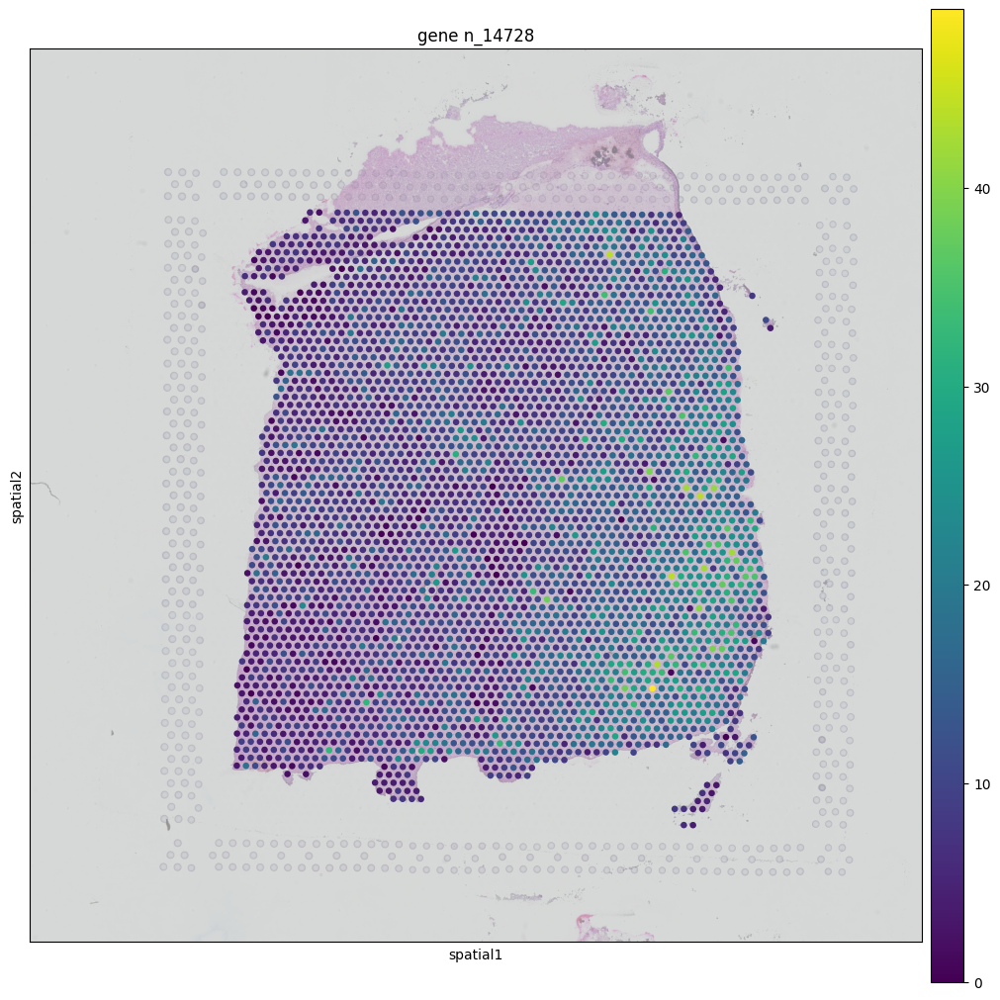

In [188]:
plot_one_in_range(scdata, 40000, 50000)

In [189]:
tot_gen_expression = scdata.X.toarray().sum(axis=0)

In [190]:
tot_gen_expression.mean()
tot_gen_expression.max()

491877.0

In [191]:
from squidpy.gr import sepal
from squidpy.gr import spatial_neighbors

In [192]:
spatial_neighbors(scdata)

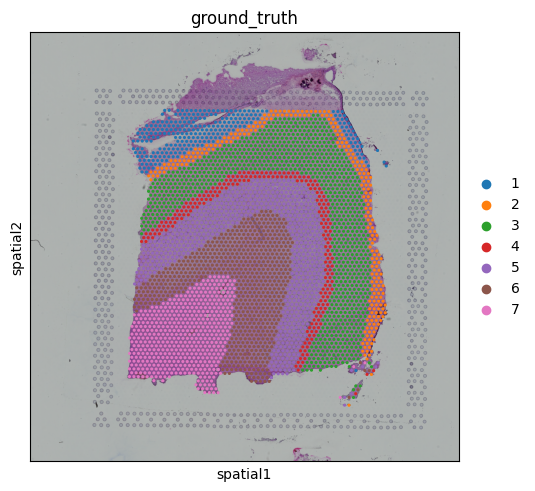

In [193]:
def fromlayerstonumber (layers):
  res=[]
  for sub in layers:
   # t=sub.replace('Layer', '')
    if sub == 'Layer1':
      res.append(str(sub).replace('Layer1', '1'))
    elif sub == 'Layer2':
      res.append(str(sub).replace('Layer2', '2'))
    elif sub == 'Layer3':
      res.append(str(sub).replace('Layer3', '3'))
    elif sub == 'Layer4':
      res.append(str(sub).replace('Layer4', '4'))
    elif sub == 'Layer5':
      res.append(str(sub).replace('Layer5', '5'))
    elif sub == 'Layer6':
      res.append(str(sub).replace('Layer6', '6'))
    elif sub == 'WM':
      res.append(str(sub).replace('WM', '7'))
    elif str(sub)=='nan' :
      res.append( res[-1]) ##nan
  return res
df_meta = pd.read_csv("1.DLPFC/151673/metadata.tsv", sep='\t')
df_meta_layer = df_meta['layer_guess']
 
adata_gene_expression.obs['ground_truth'] = fromlayerstonumber (df_meta_layer.values)

sq.pl.spatial_scatter(adata_gene_expression, color="ground_truth",cmap='Paired')

In [194]:
adata_gene_expression.var

,gene_ids,feature_types,genome
MIR1302-2HG,ENSG00000243485,Gene Expression,GRCh38
FAM138A,ENSG00000237613,Gene Expression,GRCh38
OR4F5,ENSG00000186092,Gene Expression,GRCh38
AL627309.1,ENSG00000238009,Gene Expression,GRCh38
AL627309.3,ENSG00000239945,Gene Expression,GRCh38
...,...,...,...
AC233755.2,ENSG00000277856,Gene Expression,GRCh38
AC233755.1,ENSG00000275063,Gene Expression,GRCh38
AC240274.1,ENSG00000271254,Gene Expression,GRCh38
AC213203.1,ENSG00000277475,Gene Expression,GRCh38


In [195]:
def plot_gene_expression(scdata, gene_id, path=None):
    gene_data = scdata.X.toarray().T[gene_id]
    scdata.obs["show_gene"] = list(gene_data)
    sq.pl.spatial_scatter(scdata, color="show_gene", figsize=(10,10), title=f'gene n_{gene_id}', img_alpha=0.5, save=path)

adata_gene_expression = sc.read_visium('1.DLPFC/151673', count_file='filtered_feature_bc_matrix.h5', load_images=True)
adata_gene_expression.var_names_make_unique()

sc.pp.normalize_total(adata_gene_expression, target_sum=1e4)
sc.pp.log1p(adata_gene_expression)
sc.pp.highly_variable_genes(adata_gene_expression, flavor='seurat_v3', n_top_genes=15000)

var_rank = adata_gene_expression.var["highly_variable_rank"].to_numpy()
print("num of nan: ", np.isnan(var_rank).astype(int).sum())
print("argmax: ", np.nanargmax(var_rank))
print("  ", var_rank[np.nanargmax(var_rank)])
print("argmin: ", np.nanargmin(var_rank))
print("  ", var_rank[np.nanargmin(var_rank)])

var_rank = numpy.nan_to_num(var_rank, nan=np.nanmax(var_rank)+1)
print("num of nan: ", np.isnan(var_rank).astype(int).sum())

sc.pp.normalize_total(adata_gene_expression, target_sum=1e4)
sc.pp.log1p(adata_gene_expression)
sc.pp.highly_variable_genes(adata_gene_expression, flavor='seurat_v3', n_top_genes=30000)

top_smallest = np.argsort(var_rank)[:50]
print("Indices:", top_smallest)
print(var_rank[top_smallest])

#for sm in list(top_smallest):
#    print("plotting: ", sm)
#    plot_gene_expression(scdata, sm, path=f".\\lowest_variable\\gene_{sm}")

C:\Users\Workstation\magistrale\algo_ai\Lib\site-packages\anndata\_core\anndata.py:1758: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
C:\Users\Workstation\magistrale\algo_ai\Lib\site-packages\anndata\_core\anndata.py:1758: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
C:\Users\Workstation\magistrale\algo_ai\Lib\site-packages\scanpy\preprocessing\_highly_variable_genes.py:75: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  warnings.warn(


num of nan:  18538
argmax:  24202
   14999.0
argmin:  14002
   0.0
num of nan:  0


C:\Users\Workstation\magistrale\algo_ai\Lib\site-packages\scanpy\preprocessing\_highly_variable_genes.py:75: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  warnings.warn(


Indices: [14002 29117 17855 27726 27606 18553  6546  9075  5728 17795 33494 17357
 25673  4026 31165 31043  6296 15521  6223 24872 17153  7200 17854 16169
 13576 28849 14704 30549  7834 28039 19779  1762 16915   684 31210 33339
 29592 22614  7674  5744 29645 28702   425 29694  6849 20263  4006 10602
 15993 31658]
[ 0.  1.  2.  3.  4.  5.  6.  7.  8.  9. 10. 11. 12. 13. 14. 15. 16. 17.
 18. 19. 20. 21. 22. 23. 24. 25. 26. 27. 28. 29. 30. 31. 32. 33. 34. 35.
 36. 37. 38. 39. 40. 41. 42. 43. 44. 45. 46. 47. 48. 49.]


In [197]:
adata_gene_expression = sc.read_visium('1.DLPFC/151673', count_file='filtered_feature_bc_matrix.h5', load_images=True)
adata_gene_expression.var_names_make_unique()

sc.pp.normalize_total(adata_gene_expression, target_sum=1e4)
sc.pp.log1p(adata_gene_expression)
sc.pp.highly_variable_genes(adata_gene_expression, flavor='seurat_v3', n_top_genes=15000)

var_rank = adata_gene_expression.var["highly_variable_rank"].to_numpy()
print("num of nan: ", np.isnan(var_rank).astype(int).sum())
print("argmax: ", np.nanargmax(var_rank))
print("  ", var_rank[np.nanargmax(var_rank)])
print("argmin: ", np.nanargmin(var_rank))
print("  ", var_rank[np.nanargmin(var_rank)])

var_rank = numpy.nan_to_num(var_rank, nan=np.nanmin(var_rank)-1)
print("num of nan: ", np.isnan(var_rank).astype(int).sum())

sc.pp.normalize_total(adata_gene_expression, target_sum=1e4)
sc.pp.log1p(adata_gene_expression)
sc.pp.highly_variable_genes(adata_gene_expression, flavor='seurat_v3', n_top_genes=30000)

top_largest = np.argsort(var_rank)[-50:]
print("Indices:", top_largest)
print(var_rank[top_largest])

C:\Users\Workstation\magistrale\algo_ai\Lib\site-packages\anndata\_core\anndata.py:1758: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
C:\Users\Workstation\magistrale\algo_ai\Lib\site-packages\anndata\_core\anndata.py:1758: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
C:\Users\Workstation\magistrale\algo_ai\Lib\site-packages\scanpy\preprocessing\_highly_variable_genes.py:75: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  warnings.warn(


num of nan:  18538
argmax:  24202
   14999.0
argmin:  14002
   0.0
num of nan:  0
Indices: [  345  9643  1839  5623 22160  8594 30488  3015 16324 19345 16271 28373
 26426 20977 20723  2146 11160 25205 25299  4145 18324 22388 23248  8969
 21283  1833 32515 28475 21026 25070 14787 24514   400 30528 29060 24755
 24344 19350 29580 17274 11958  2457 19212 14186 33371  5419   692 14362
 13754 24202]
[14950. 14951. 14952. 14953. 14954. 14955. 14956. 14957. 14958. 14959.
 14960. 14961. 14962. 14963. 14964. 14965. 14966. 14967. 14968. 14969.
 14970. 14971. 14972. 14973. 14974. 14975. 14976. 14977. 14978. 14979.
 14980. 14981. 14982. 14983. 14984. 14985. 14986. 14987. 14988. 14989.
 14990. 14991. 14992. 14993. 14994. 14995. 14996. 14997. 14998. 14999.]


C:\Users\Workstation\magistrale\algo_ai\Lib\site-packages\scanpy\preprocessing\_highly_variable_genes.py:75: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  warnings.warn(


In [ ]:
for i, sm in enumerate(list(top_largest)):
    print(f"{i}] plotting: ", sm)
    plot_gene_expression(scdata, sm, path=f".\\highest_variable\\gene_{sm}")

In [209]:
def plot_gene_expression(scdata, gene_id, path=None):
    gene_data = scdata.X.toarray().T[gene_id]
    scdata.obs["show_gene"] = list(gene_data)
    sq.pl.spatial_scatter(scdata, color="show_gene", figsize=(10,10), title=f'gene n_{gene_id}', img_alpha=0.5, save=path)

adata_gene_expression = sc.read_visium('1.DLPFC/151673', count_file='filtered_feature_bc_matrix.h5', load_images=True)
adata_gene_expression.var_names_make_unique()

sc.pp.normalize_total(adata_gene_expression, target_sum=1e4)
sc.pp.log1p(adata_gene_expression)
sc.pp.highly_variable_genes(adata_gene_expression, flavor='seurat_v3', n_top_genes=30000)

var_rank = adata_gene_expression.var["highly_variable_rank"].to_numpy()
nan_indexes = np.argwhere(np.isnan(var_rank)).flatten()
nan_indexes = list(nan_indexes)

C:\Users\Workstation\magistrale\algo_ai\Lib\site-packages\anndata\_core\anndata.py:1758: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
C:\Users\Workstation\magistrale\algo_ai\Lib\site-packages\anndata\_core\anndata.py:1758: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
C:\Users\Workstation\magistrale\algo_ai\Lib\site-packages\scanpy\preprocessing\_highly_variable_genes.py:75: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  warnings.warn(


In [210]:
adata_gene_expression

,gene_ids,feature_types,genome,highly_variable,highly_variable_rank,means,variances,variances_norm
MIR1302-2HG,ENSG00000243485,Gene Expression,GRCh38,True,9819.0,0.000281,0.000287,1.000565
FAM138A,ENSG00000237613,Gene Expression,GRCh38,True,25710.0,0.000000,0.000000,0.000000
OR4F5,ENSG00000186092,Gene Expression,GRCh38,True,25705.0,0.000000,0.000000,0.000000
AL627309.1,ENSG00000238009,Gene Expression,GRCh38,True,20938.0,0.004014,0.004114,0.839196
AL627309.3,ENSG00000239945,Gene Expression,GRCh38,True,25701.0,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...
AC233755.2,ENSG00000277856,Gene Expression,GRCh38,True,25715.0,0.000000,0.000000,0.000000
AC233755.1,ENSG00000275063,Gene Expression,GRCh38,True,25716.0,0.000000,0.000000,0.000000
AC240274.1,ENSG00000271254,Gene Expression,GRCh38,True,21351.0,0.001778,0.001702,0.789476
AC213203.1,ENSG00000277475,Gene Expression,GRCh38,False,NaN,0.000000,0.000000,0.000000


In [199]:
len(nan_indexes)

3538

In [ ]:
for i in range(50):
    sm = choice(nan_indexes)
    print(f"{i}] plotting: ", sm)
    plot_gene_expression(scdata, sm, path=f".\\nan_variable\\gene_{sm}")

In [ ]:
plot_gene_expression(scdata, 25673)

In [107]:
gene_id = 25673
gene_data = scdata.X.toarray().T[gene_id]
gene_data.sum()

4.693061

In [108]:
gene_id = 27606
gene_data = scdata.X.toarray().T[gene_id]
gene_data.sum()

5295.6475

In [120]:
tot_gene_expression    = scdata.X.toarray().sum(axis=0)
low_expression_indexes = np.where(tot_gene_expression < 100)[0]

(21218,)

In [211]:
def plot_gene_expression(scdata, gene_id, path=None):
    gene_data = scdata.X.toarray().T[gene_id]
    scdata.obs["show_gene"] = list(gene_data)
    sq.pl.spatial_scatter(scdata, color="show_gene", figsize=(10,10), title=f'gene n_{gene_id}', img_alpha=0.5, save=path)

adata_gene_expression = sc.read_visium('1.DLPFC/151673', count_file='filtered_feature_bc_matrix.h5', load_images=True)
adata_gene_expression.var_names_make_unique()

sc.pp.normalize_total(adata_gene_expression, target_sum=1e4)
sc.pp.log1p(adata_gene_expression)
sc.pp.highly_variable_genes(adata_gene_expression, flavor='seurat_v3', n_top_genes=30000)

var_rank = adata_gene_expression.var["highly_variable_rank"].to_numpy()
var_rank = numpy.nan_to_num(var_rank, nan=np.nanmax(var_rank)+1)

(var_rank == np.nanmax(var_rank)).astype(int).sum()

C:\Users\Workstation\magistrale\algo_ai\Lib\site-packages\anndata\_core\anndata.py:1758: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
C:\Users\Workstation\magistrale\algo_ai\Lib\site-packages\anndata\_core\anndata.py:1758: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
C:\Users\Workstation\magistrale\algo_ai\Lib\site-packages\scanpy\preprocessing\_highly_variable_genes.py:75: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  warnings.warn(


3538

,gene_ids,feature_types,genome
MIR1302-2HG,ENSG00000243485,Gene Expression,GRCh38
FAM138A,ENSG00000237613,Gene Expression,GRCh38
OR4F5,ENSG00000186092,Gene Expression,GRCh38
AL627309.1,ENSG00000238009,Gene Expression,GRCh38
AL627309.3,ENSG00000239945,Gene Expression,GRCh38
...,...,...,...
AC233755.2,ENSG00000277856,Gene Expression,GRCh38
AC233755.1,ENSG00000275063,Gene Expression,GRCh38
AC240274.1,ENSG00000271254,Gene Expression,GRCh38
AC213203.1,ENSG00000277475,Gene Expression,GRCh38


In [212]:
tot_gene_expression    = adata_gene_expression.X.toarray().sum(axis=0)
low_expression_indexes = np.where(tot_gene_expression < 100)[0]
var_rank[low_expression_indexes] = np.nanmax(var_rank)

(var_rank == np.nanmax(var_rank)).astype(int).sum()

21926

In [213]:
sc.pp.normalize_total(adata_gene_expression, target_sum=1e4)
sc.pp.log1p(adata_gene_expression)
sc.pp.highly_variable_genes(adata_gene_expression, flavor='seurat_v3', n_top_genes=30000)

top_smallest = np.argsort(var_rank)[:50]
print("Indices:", top_smallest)
print(var_rank[top_smallest])

# for sm in list(top_smallest):
#    print("plotting: ", sm)
#    plot_gene_expression(scdata, sm, path=f".\\high_epxression_lowest_variable\\gene_{sm}")

Indices: [14002 29117 17855 27726 27606 18553  6546  9075  5728 33494  4026 31165
 31043  6223 17153 17854 14704  7834 19779 16915   684 22614  5744  6849
  4617 23765 32395 21232 27993 25081 18002  4756 20428  7101 10542 23218
  6665 18098 19352 27588  8843  3337  8301 10214 11714 29313  2043 23758
 15448 23163]
[  0.   1.   2.   3.   4.   5.   6.   7.   8.  10.  13.  14.  15.  18.
  20.  22.  26.  28.  30.  32.  33.  37.  39.  44.  53.  62.  64.  67.
  81.  84.  90.  91.  95. 105. 107. 109. 112. 114. 115. 119. 121. 123.
 130. 131. 132. 136. 140. 141. 144. 145.]


C:\Users\Workstation\magistrale\algo_ai\Lib\site-packages\scanpy\preprocessing\_highly_variable_genes.py:75: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  warnings.warn(


In [ ]:
sc.pp.highly_variable_genes(adata_gene_expression, flavor='seurat_v3', n_top_genes=10000)

adata_gene_expression.var["highly_variable"].to_numpy().astype(int).sum()

In [1]:
import numpy as np

def plot_gene_expression(data, gene_data, gene_id=None, path=None, alpha=0.5):
    scdata.obs["show_gene"] = gene_data
    if gene_id:
        title = f"gene n_{gene_id}"
    else:
        title = "gene"
    sq.pl.spatial_scatter(data, color="show_gene", figsize=(20,10), title=title, cmap="summer", img_alpha=alpha, save=path)

def plot_gene_expression_by_id(data, gene_id, path=None, alpha=0.5):
    gene_data = scdata.X.toarray().T[gene_id]
    plot_gene_expression(data, list(gene_data), gene_id=gene_id, path=path, alpha=alpha)

def mean_filter(scdata, gene_data, coord_to_idx=None):
    
    if not coord_to_idx:
        coord_to_idx = dict()
        for i, ind in enumerate(scdata.obs.index):
            coord_to_idx[( scdata.obs['array_row'][ind], scdata.obs['array_col'][ind])] = i

    gene_data_filtered  = np.zeros(gene_data.shape)

    for i, ind in enumerate(scdata.obs.index):
        ind_col = scdata.obs['array_col'][ind]
        ind_row = scdata.obs['array_row'][ind]

        neighs_val = gene_data[i]
        num_neighs = 0

        def update_values(row_idx, col_idx):
            nonlocal neighs_val, num_neighs
            if (row_idx, col_idx) in coord_to_idx:
                neigh_idx      = coord_to_idx[(row_idx, col_idx)]
                neighs_val    += gene_data[neigh_idx]
                num_neighs    += 1
        
        update_values(ind_row,   ind_col-2)
        update_values(ind_row,   ind_col+2)
        update_values(ind_row-1, ind_col-1)
        update_values(ind_row-1, ind_col+1)
        update_values(ind_row+1, ind_col-1)
        update_values(ind_row+1, ind_col+1)

        gene_data_filtered[i] = neighs_val / (num_neighs + 1) 
            
    return gene_data_filtered

def expansion_filter(data, gene_data, coord_to_idx=None):
    
    if not coord_to_idx:
        coord_to_idx = dict()
        for i, ind in enumerate(scdata.obs.index):
            coord_to_idx[( scdata.obs['array_row'][ind], scdata.obs['array_col'][ind])] = i

    gene_data_expanded  = np.zeros(gene_data.shape).astype(int)

    for i, ind in enumerate(scdata.obs.index):
        ind_col = scdata.obs['array_col'][ind]
        ind_row = scdata.obs['array_row'][ind]

        # TODO: activate or deactivate also based on the number of neighbours, 
        #       not hardcoded 3. Problem is on the border cells.
        
        is_active     = gene_data[i] == 1 
        active_neighs = 0

        def update_active_neighbours(row_idx, col_idx):
            nonlocal active_neighs
            if (row_idx, col_idx) in coord_to_idx:
                neigh_idx      = coord_to_idx[(row_idx, col_idx)]
                active_neighs += gene_data[neigh_idx]

        update_active_neighbours(ind_row,   ind_col-2)
        update_active_neighbours(ind_row,   ind_col+2)
        update_active_neighbours(ind_row-1, ind_col-1)
        update_active_neighbours(ind_row-1, ind_col+1)
        update_active_neighbours(ind_row+1, ind_col-1)
        update_active_neighbours(ind_row+1, ind_col+1)

        if is_active and active_neighs >= 3:
            gene_data_expanded[i] = 1
        elif not is_active and active_neighs > 3:
            gene_data_expanded[i] = 1

    return gene_data_expanded

def plot_transformed(data, gene_id, std_ratio=2, expansion_it=10, mean_filter_it=3, path=None):
    
    # extract single gene data
    gene_data = data.X.toarray().T[gene_id]

    # calculate coord to index map
    coord_to_idx = dict()
    for i, ind in enumerate(scdata.obs.index):
        coord_to_idx[( scdata.obs['array_row'][ind], scdata.obs['array_col'][ind])] = i

    # apply mean filter
    for _ in range(mean_filter_it):
        gene_data = mean_filter(data, gene_data, coord_to_idx)

    # apply integer thresholding based on mean and std
    mean      = gene_data.mean()
    std       = gene_data.std()
    gene_data = (gene_data > (mean - std/std_ratio)).astype(int)

    # apply expansion filter
    for _ in range(expansion_it):
        gene_data = expansion_filter(scdata, gene_data, coord_to_idx)
    
    plot_gene_expression(data, list(gene_data), gene_id=gene_id, path=path)
    

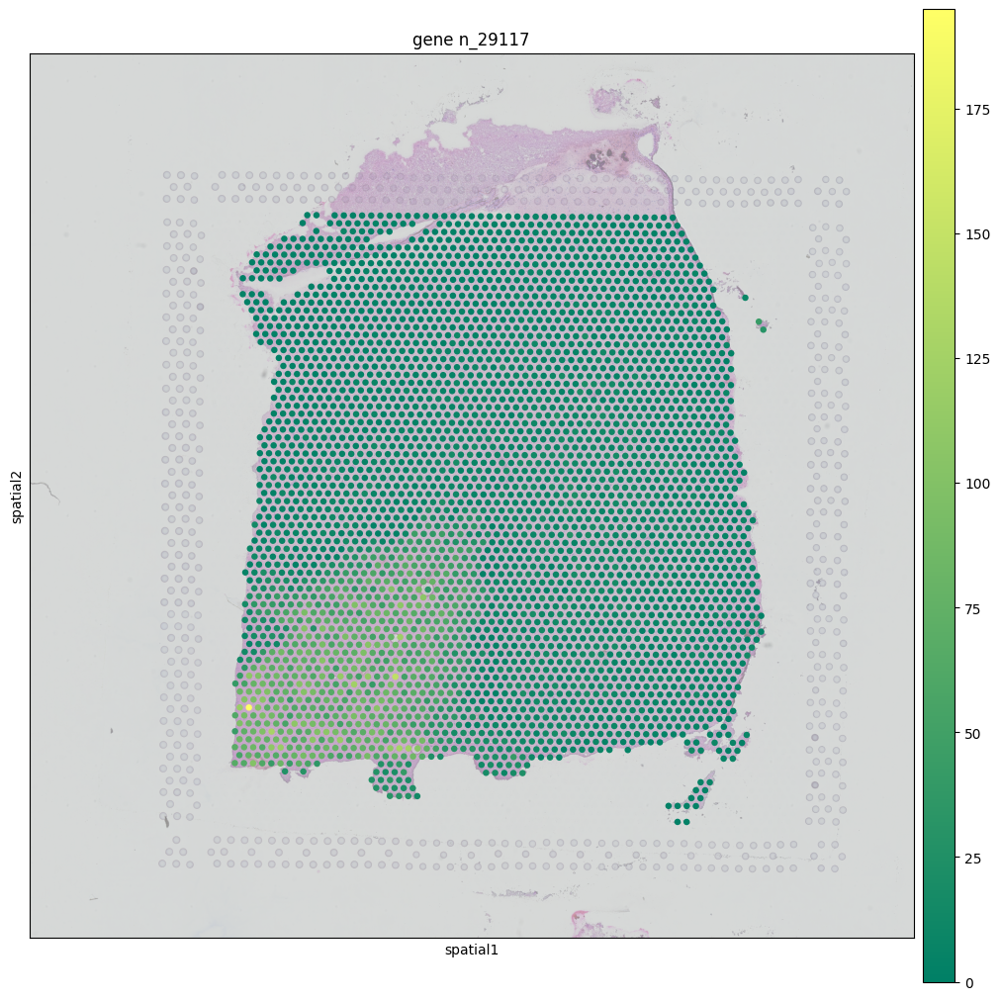

In [7]:
plot_gene_expression_by_id(adata_gene_expression, gene_id=29117)

In [ ]:
STDR    = [2, 4, 100]
EXPITS  = [0, 4, 8]
MFITS   = [1, 4, 8]

gene_id = 13982

for std_ratio in STDR:
    for expansion_it in EXPITS:
        for mean_filter_it in MFITS:    
            plot_transformed(
                scdata, 
                gene_id        = gene_id, 
                std_ratio      = std_ratio, 
                expansion_it   = expansion_it, 
                mean_filter_it = mean_filter_it, 
                path           = f".\\gene{gene_id}\\plot_STDR-{std_ratio}_EXPIT-{expansion_it}_MFIT-{mean_filter_it}")

plotting at percentile=0
plotting at percentile=5
plotting at percentile=10
plotting at percentile=15
plotting at percentile=20
plotting at percentile=25
plotting at percentile=30
plotting at percentile=35
plotting at percentile=40
plotting at percentile=45
plotting at percentile=50
plotting at percentile=55
plotting at percentile=60
plotting at percentile=65
plotting at percentile=70
plotting at percentile=75
plotting at percentile=80
plotting at percentile=85
plotting at percentile=90
plotting at percentile=95


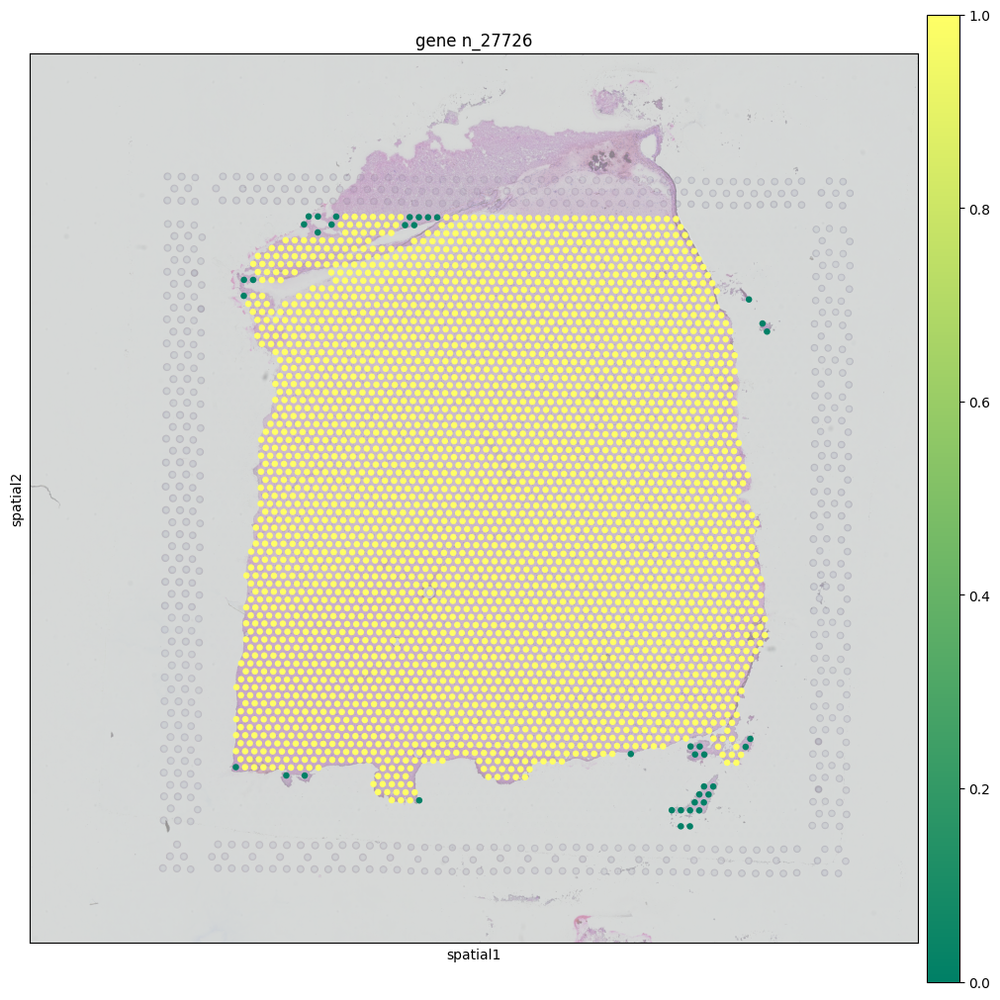

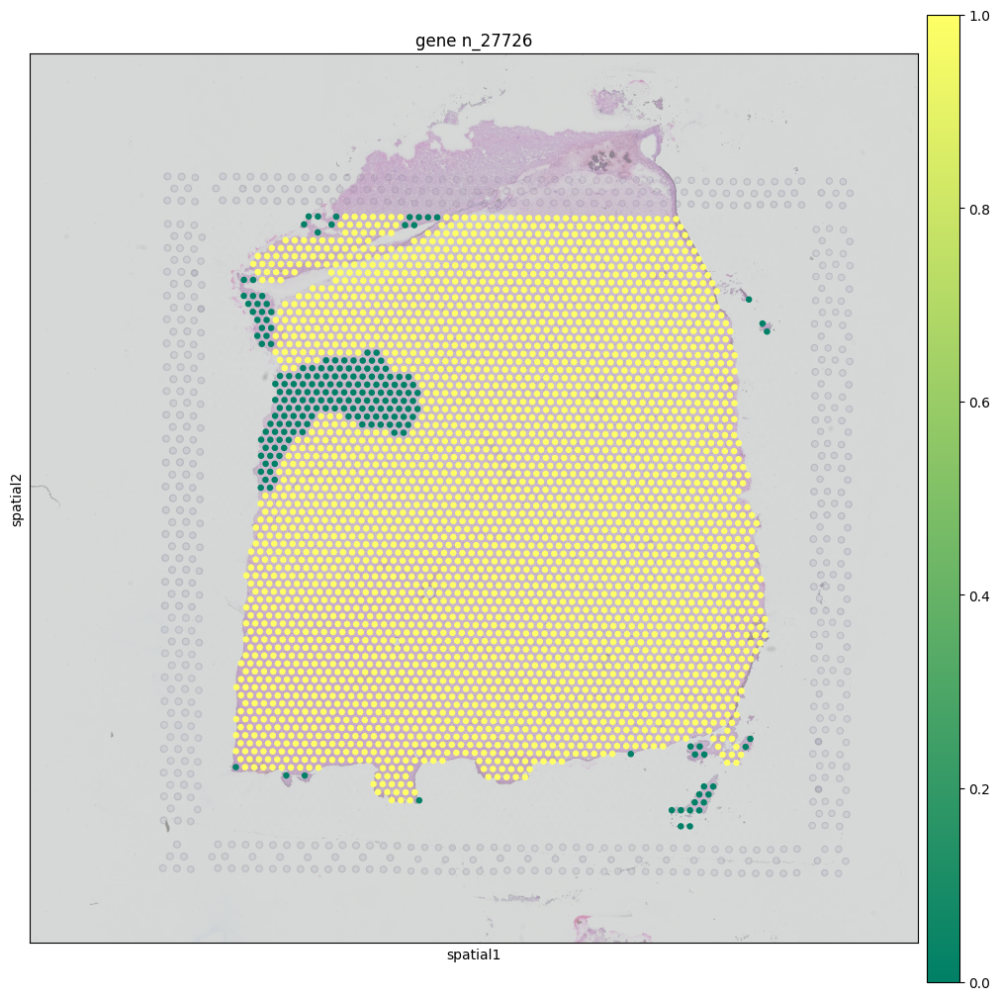

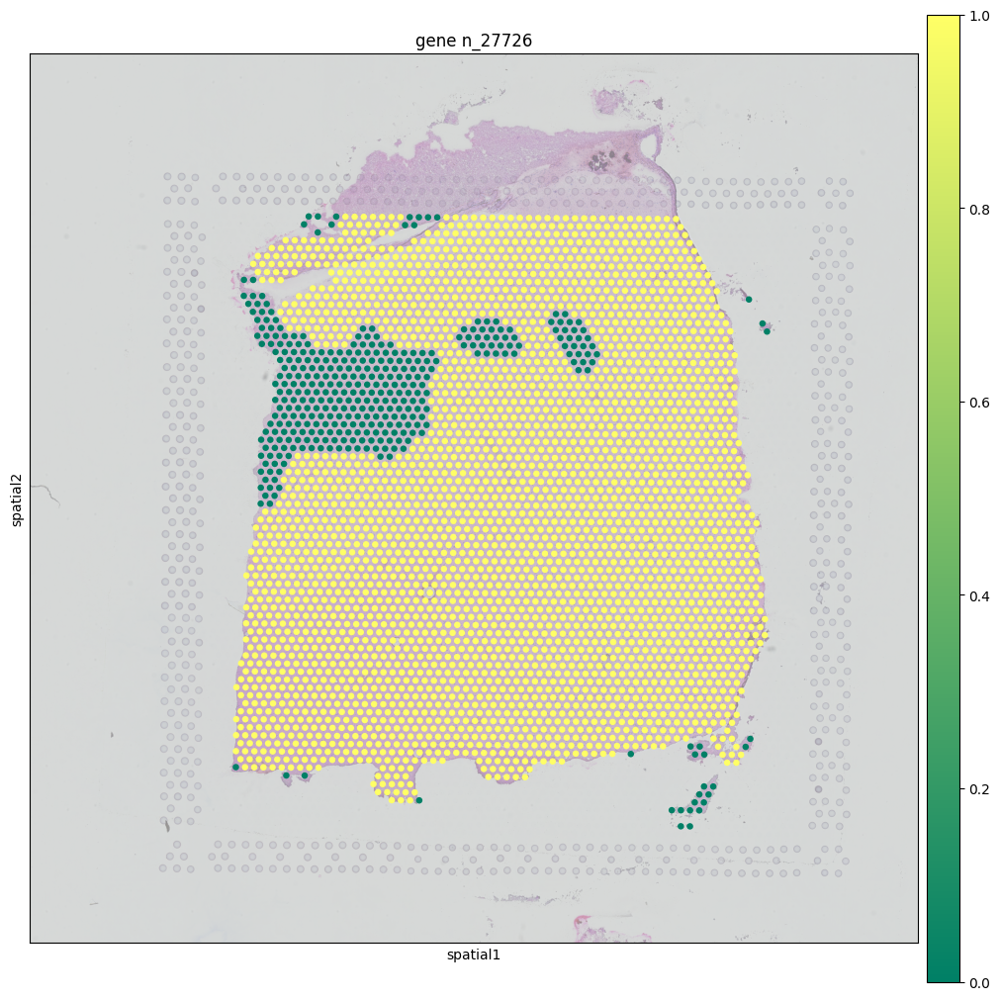

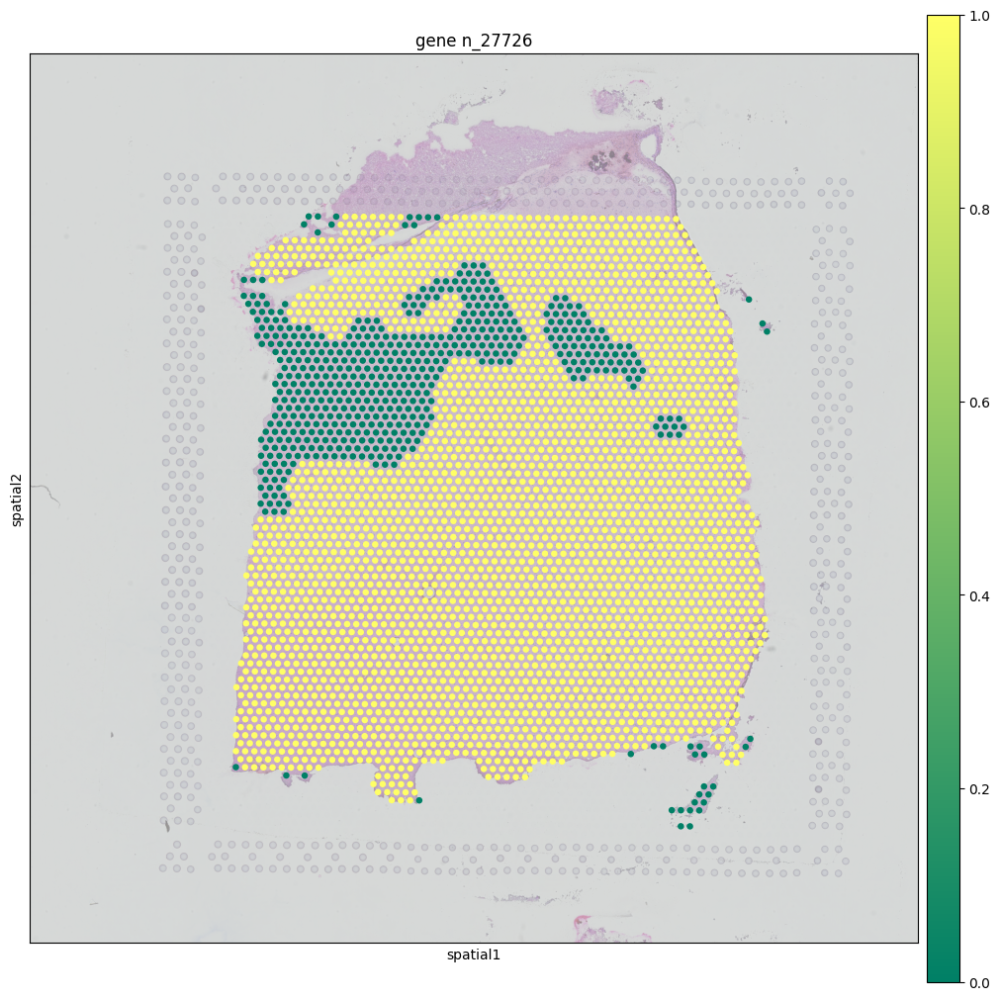

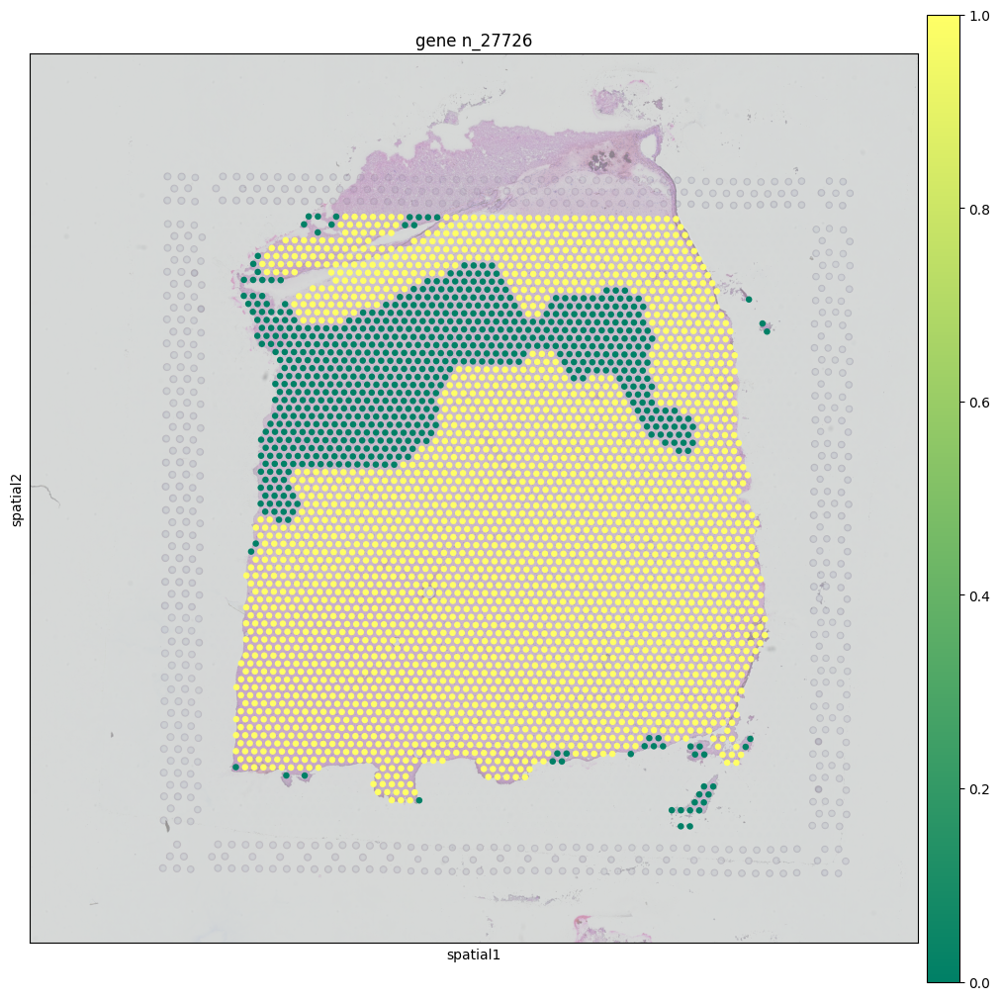

...

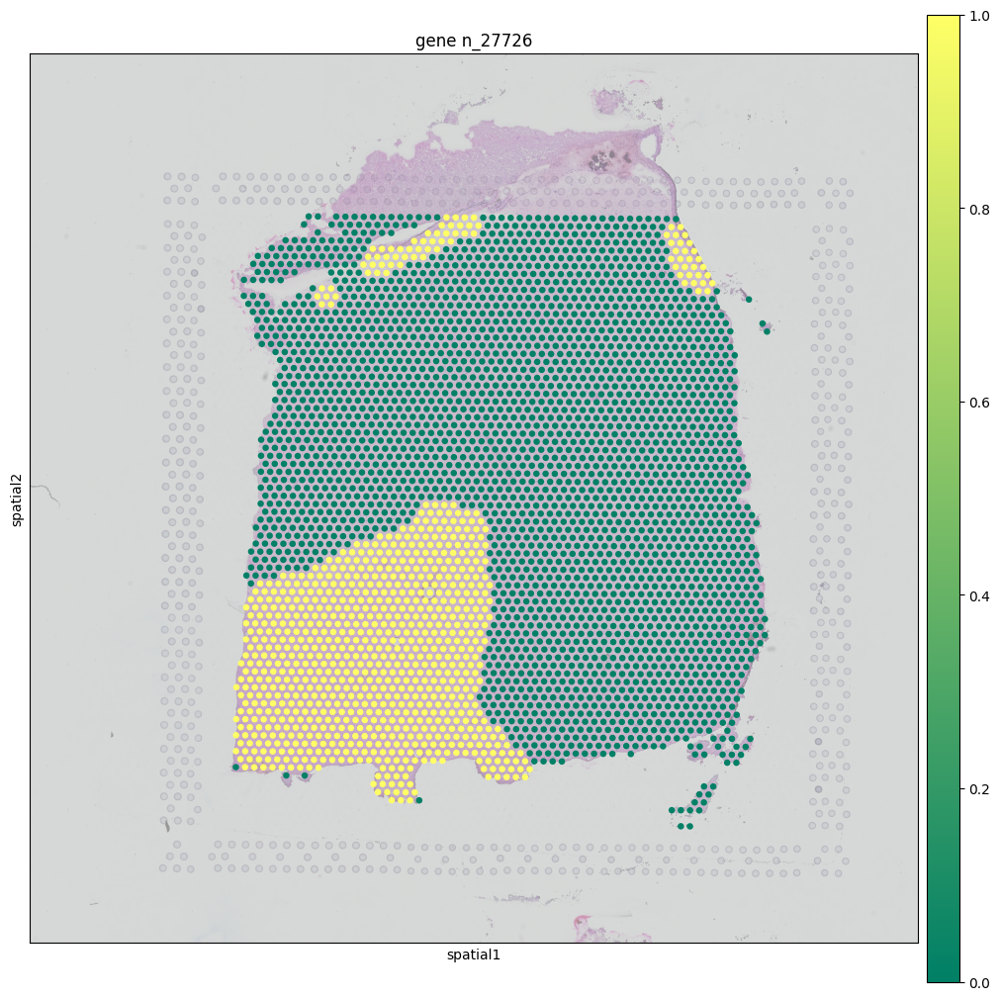

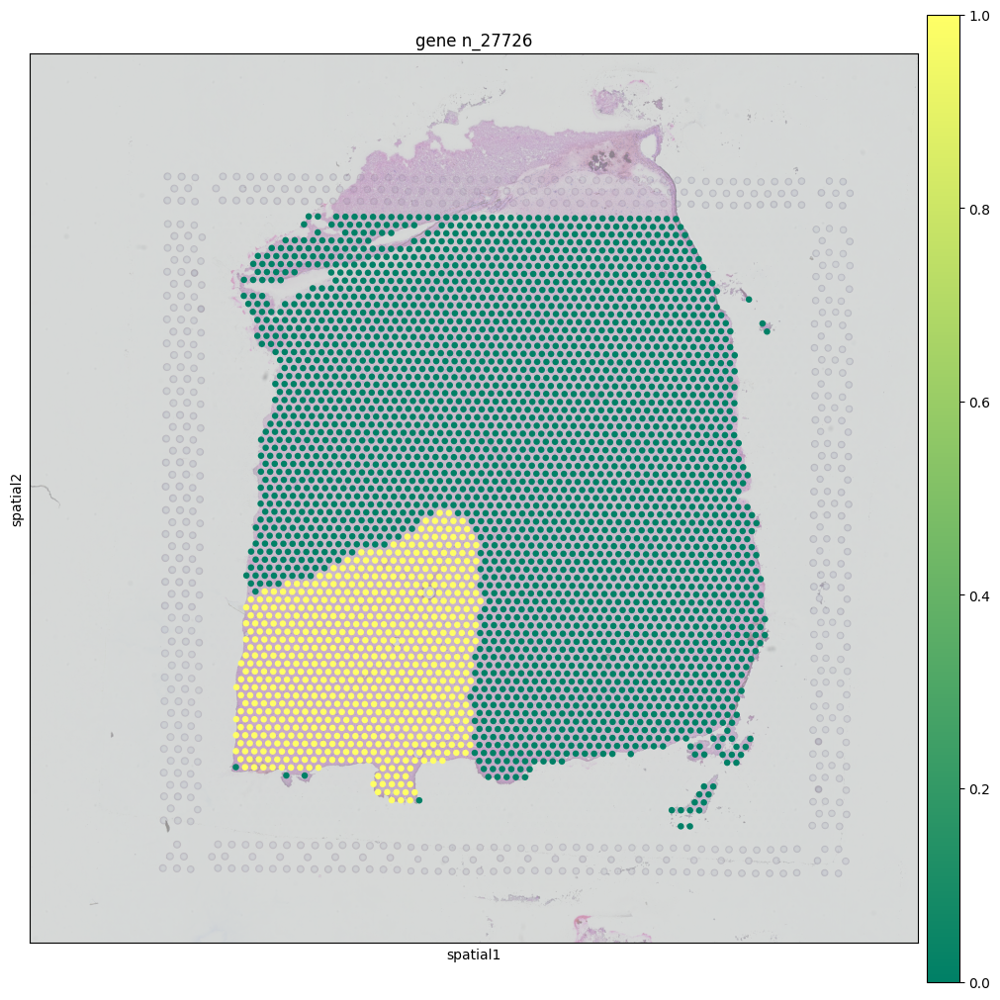

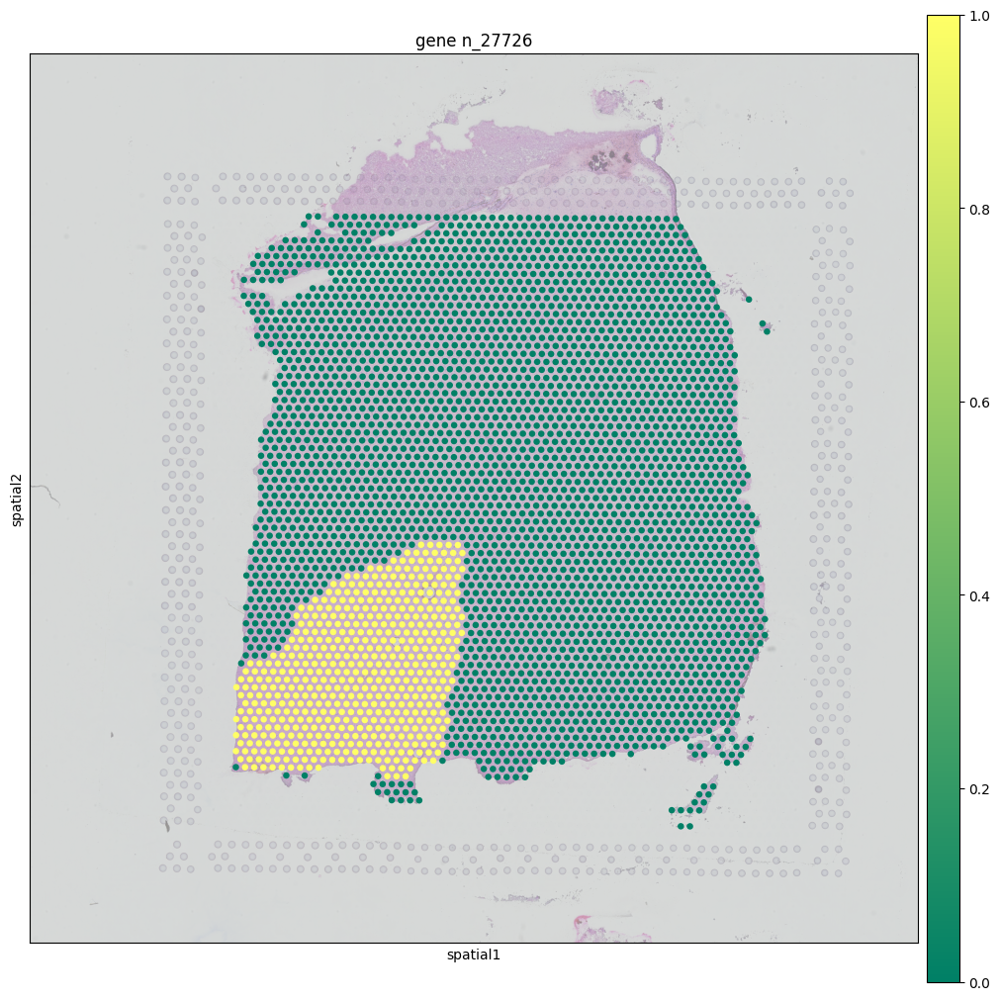

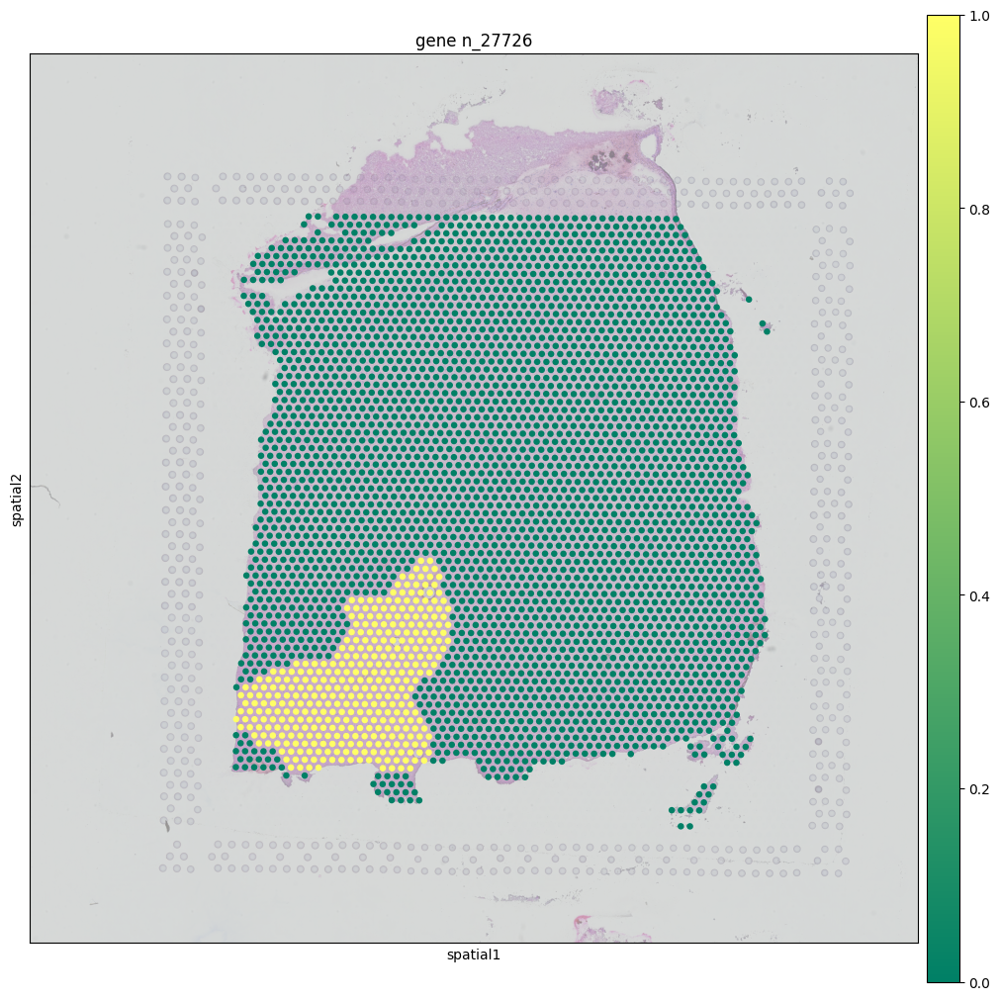

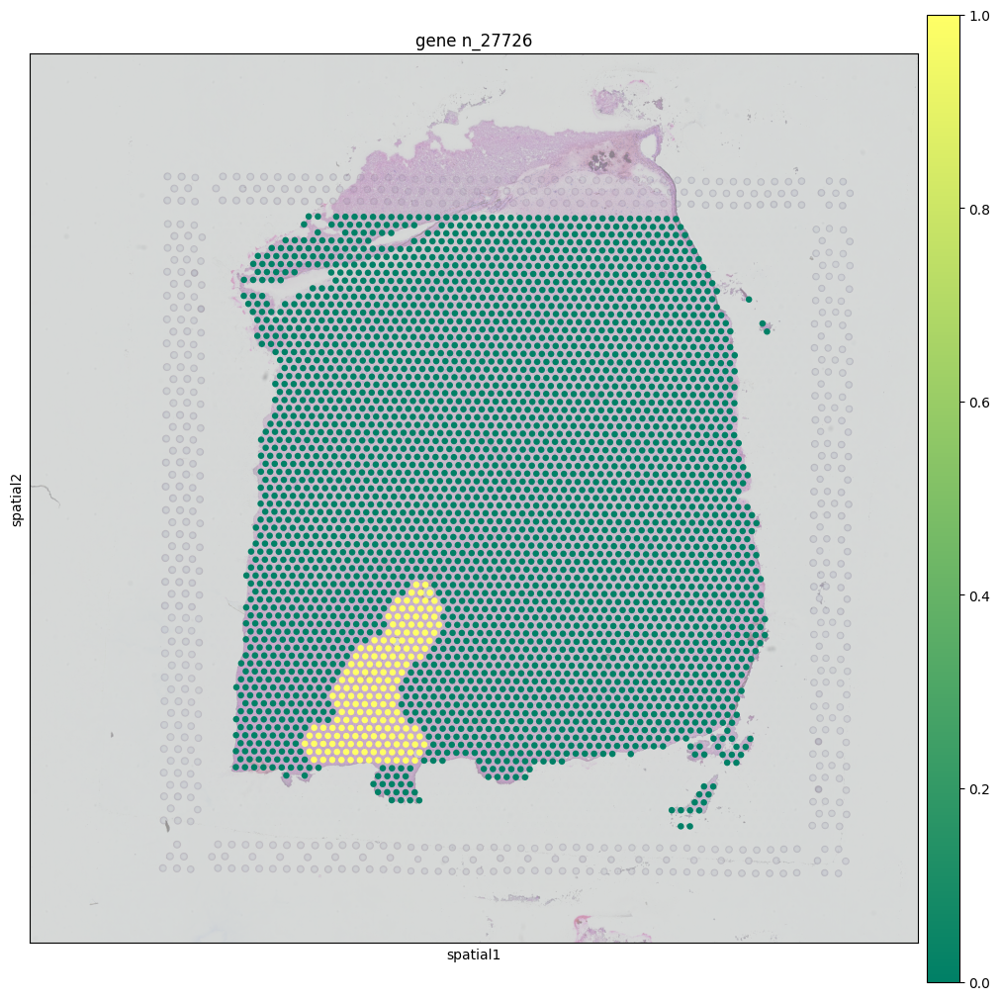

In [118]:
gene_id = 27726
for i in range(20):
    print(f"plotting at percentile={i*5}")
    gene_data = scdata.X.toarray().T[gene_id]
    
    for _ in range(5):
        gene_data = mean_filter(scdata, gene_data)
    
    perc      = np.percentile(gene_data, i*5)
    gene_data = (gene_data > perc).astype(int)
    
    for _ in range(5):
        gene_data = expansion_filter(scdata, gene_data)
        
    plot_gene_expression(scdata, list(gene_data), gene_id=gene_id, path=f".\\gene_{gene_id}\\plt_PERC-{i*5}")

In [215]:
for gene_id in top_smallest:
    gene_data = scdata.X.toarray().T[gene_id]
    gmin = gene_data.min()
    gmax = gene_data.max()
    bs   = np.linspace(gmin-0.5, gmax+0.5, int(abs(gmin-gmax)) + 2)
    plt.hist(gene_data, bins=bs)
    plt.savefig(f".\\figures\\gene_distributions\\gene_{gene_id}.png")
    plt.clf()

<Figure size 640x480 with 0 Axes>

In [171]:


gene_id = 10060



#for _ in range(0):
#    gene_data = mean_filter(scdata, gene_data)

#bars = []
#for i in range(int(gene_data.max())):
#    bars.append(np.logical_and(gene_data > i - 0.5, gene_data < i + 0.5).astype(int).sum())

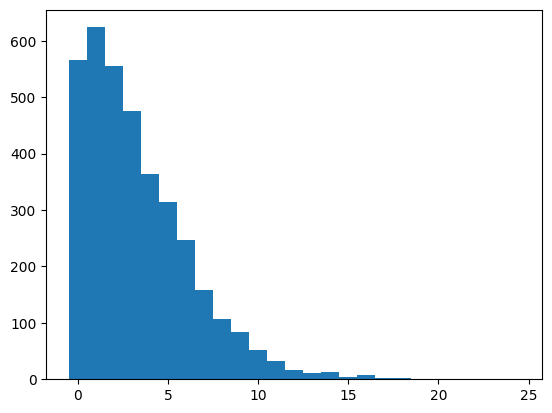

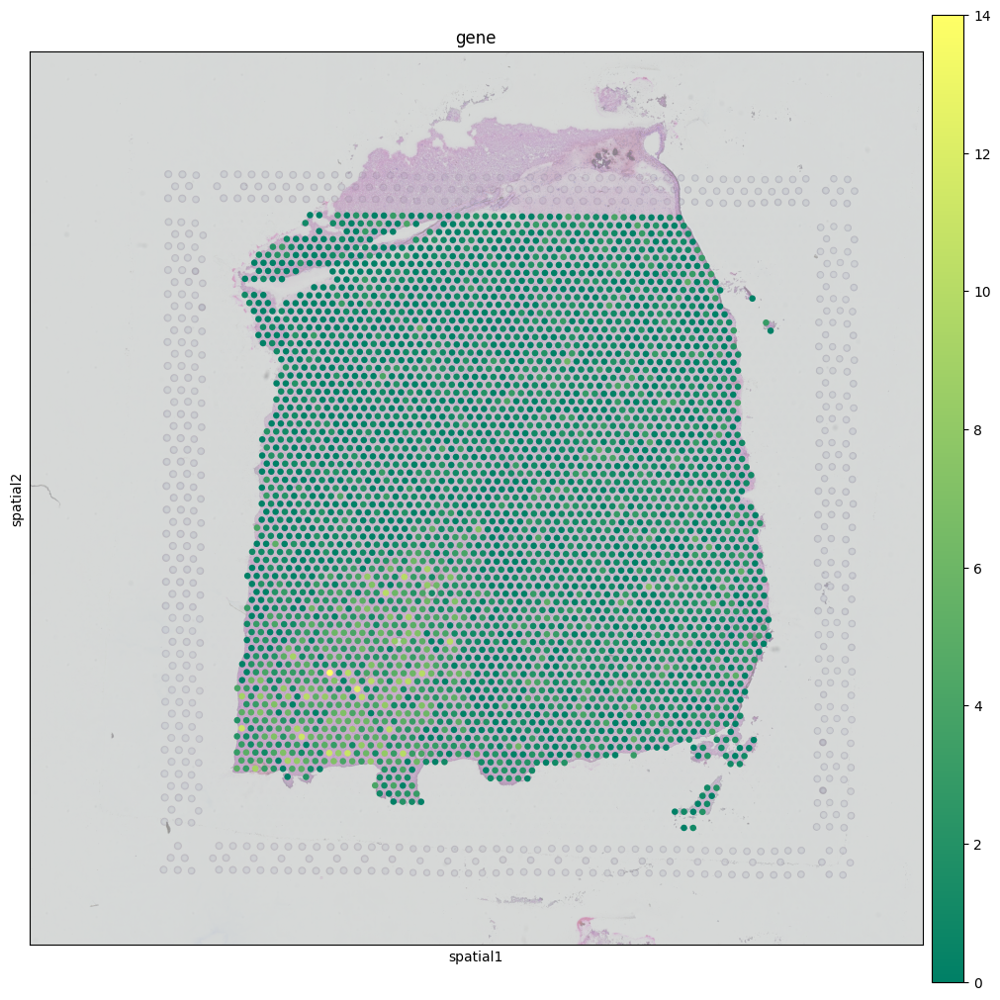

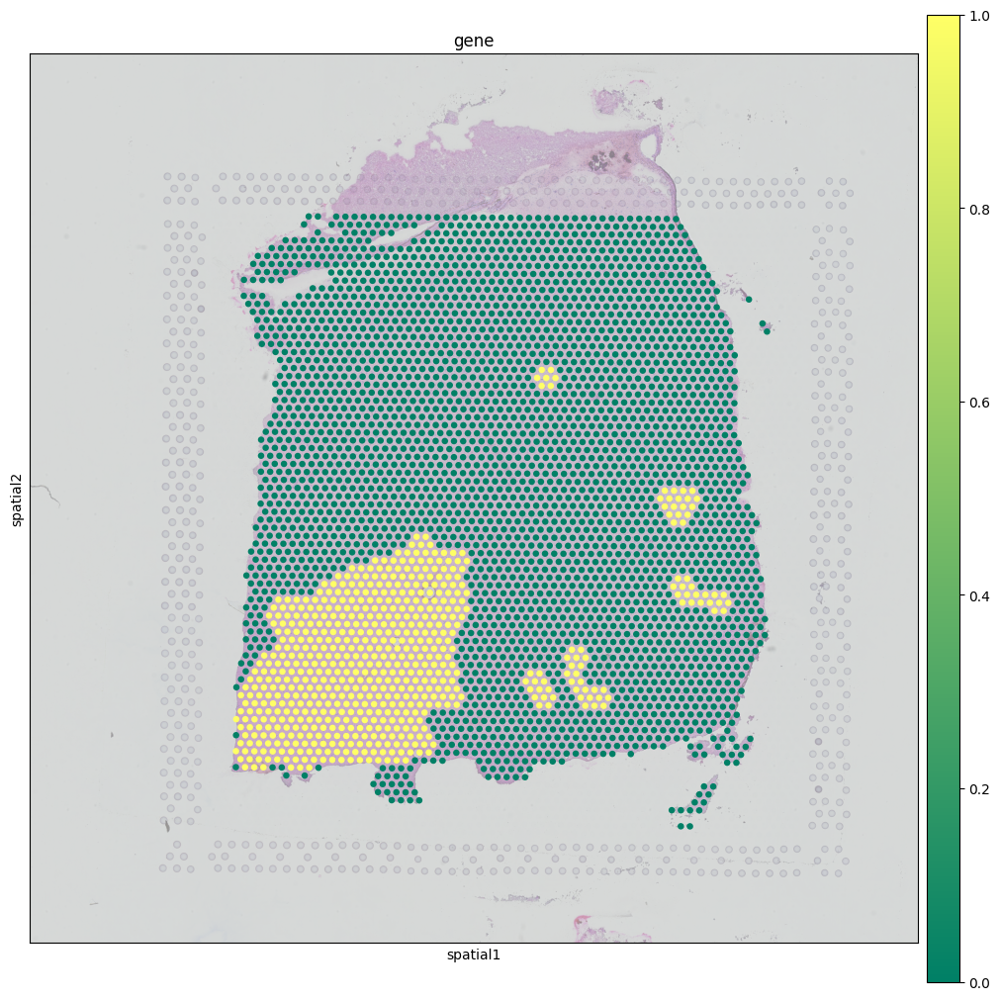

In [99]:
plot_gene_expression(scdata, list(gene_data))

gene_data = (gene_data > gene_data.mean()).astype(int)
for _ in range(5):
    gene_data = expansion_filter(scdata, gene_data)

plot_gene_expression(scdata, list(gene_data))

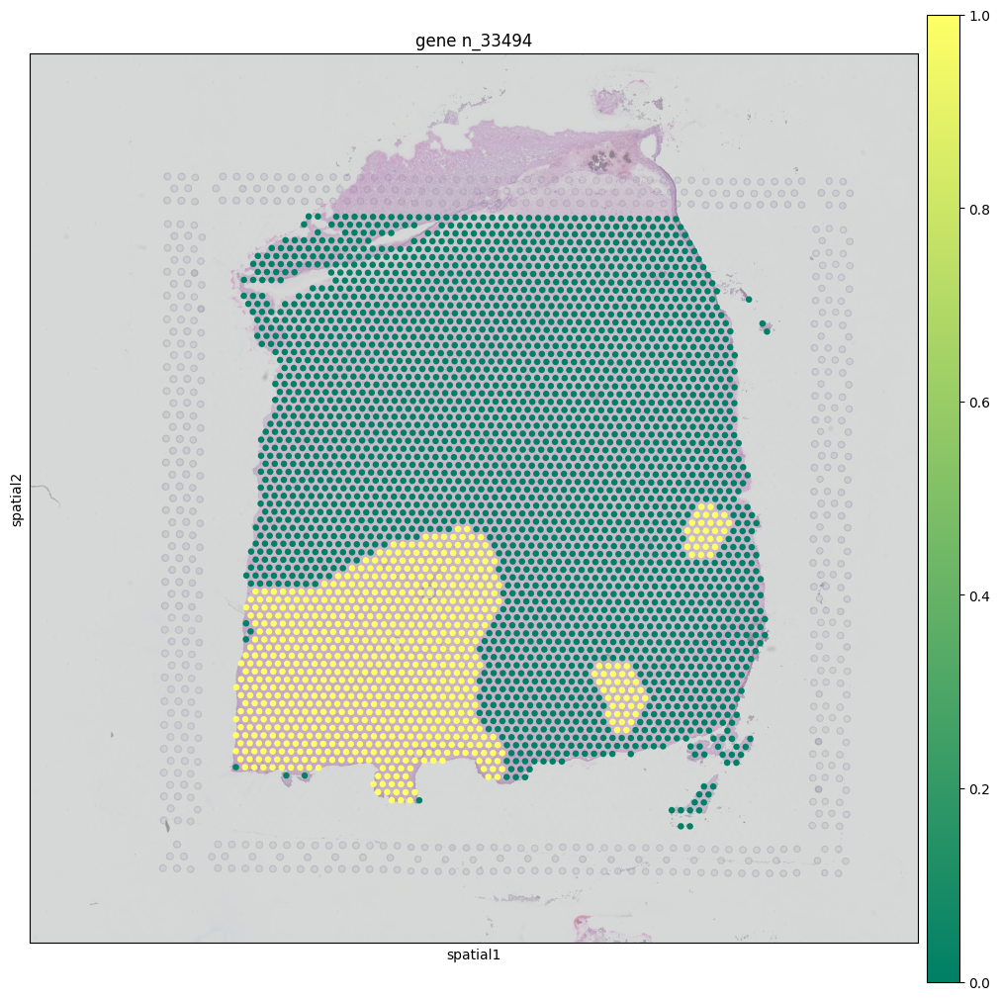

In [227]:
plot_transformed(
    scdata, 
    gene_id        = 33494, 
    std_ratio      = 100, 
    expansion_it   = 5, 
    mean_filter_it = 10, 
    path           = None)